In [29]:
##import libraries
import pandas as pd
import numpy as np
import plotly.express as px

In [30]:
#import csv
df = pd.read_csv("BigML_Dataset.csv")
#preview
df.head()

C:\Users\user\AppData\Local\Temp\ipykernel_4900\372269078.py:2: DtypeWarning:

Columns (16) have mixed types. Specify dtype option on import or set low_memory=False.



,ID,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,Age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,Unnamed: 12,Unnamed: 13,Unnamed: 14,Unnamed: 15,Unnamed: 16
0,15.0,0.0,0.019657,76.0,0.0,477.0,0.0,6.0,0.0,1.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
1,51.0,0.0,0.818978,73.0,0.0,3095.0,0.0,9.0,0.0,1.0,1.0,0.0,NaN,NaN,NaN,NaN,NaN
2,74.0,0.0,0.059669,31.0,0.0,3162.0,0.0,11.0,0.0,2.0,0.0,1.0,NaN,NaN,NaN,NaN,NaN
3,91.0,0.0,0.039388,51.0,0.0,15466.0,0.0,7.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN
4,299.0,0.0,0.085152,25.0,0.0,1005.0,0.0,5.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN


In [31]:
cols = [0, 12,13,14,15,16]
df.drop(df.columns[cols],axis=1, inplace=True)

In [32]:
df.shape

(1048575, 11)

## Dealing with Missing values

In [33]:
df.isnull().sum()/len(df)

SeriousDlqin2yrs                        0.856949
RevolvingUtilizationOfUnsecuredLines    0.856949
Age                                     0.856949
NumberOfTime30-59DaysPastDueNotWorse    0.856949
DebtRatio                               0.856949
MonthlyIncome                           0.885301
NumberOfOpenCreditLinesAndLoans         0.856949
NumberOfTimes90DaysLate                 0.856949
NumberRealEstateLoansOrLines            0.856949
NumberOfTime60-89DaysPastDueNotWorse    0.856949
NumberOfDependents                      0.860691
dtype: float64

More than 85% of the data is missing. It is better to discrad all the missing values

In [34]:
df.dropna(inplace=True)

In [35]:
df["SeriousDlqin2yrs"] = df["SeriousDlqin2yrs"].astype('category')

In [36]:
df.describe()

,RevolvingUtilizationOfUnsecuredLines,Age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,120269.000000,120269.000000,120269.000000,120269.000000,1.202690e+05,120269.000000,120269.000000,120269.000000,120269.000000,120269.000000
mean,5.899873,51.289792,0.381769,26.598777,6.670221e+03,8.758475,0.211925,1.054519,0.187829,0.851832
std,257.040685,14.426684,3.499234,424.446457,1.438467e+04,5.172835,3.465276,1.149273,3.447901,1.148391
min,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.035084,40.000000,0.000000,0.143388,3.400000e+03,5.000000,0.000000,0.000000,0.000000,0.000000
50%,0.177282,51.000000,0.000000,0.296023,5.400000e+03,8.000000,0.000000,1.000000,0.000000,0.000000
75%,0.579428,61.000000,0.000000,0.482559,8.249000e+03,11.000000,0.000000,2.000000,0.000000,2.000000
max,50708.000000,103.000000,98.000000,61106.500000,3.008750e+06,58.000000,98.000000,54.000000,98.000000,20.000000


### Data Visualizations

In [37]:
fig = px.histogram(df, x="NumberOfDependents", color="SeriousDlqin2yrs", template='none', barmode="group",# can be `box`, `violin`
                         hover_data=df.columns)


fig.show()

In [38]:
fig = px.histogram(df, x="NumberRealEstateLoansOrLines", color="SeriousDlqin2yrs", template='none', barmode="group",# can be `box`, `violin`
                         hover_data=df.columns)


fig.show()

In [39]:
fig = px.box(df, y="NumberOfOpenCreditLinesAndLoans")
fig.show()

In [40]:
df = df[df["MonthlyIncome"]<20000]
fig = px.histogram(df, x="MonthlyIncome", color="SeriousDlqin2yrs", template='none', barmode="group",# can be `box`, `violin`
                         hover_data=df.columns)


fig.show()

In [52]:
from statistics import median

df['DebtRatio'] = df['DebtRatio'].apply(lambda x: median(df['DebtRatio']) if x < 0 else x)
df['DebtRatio'] = df['DebtRatio'].apply(lambda x: median(df['DebtRatio']) if x > 1 else x)

In [53]:

fig = px.box(df, y="DebtRatio")
fig.show()

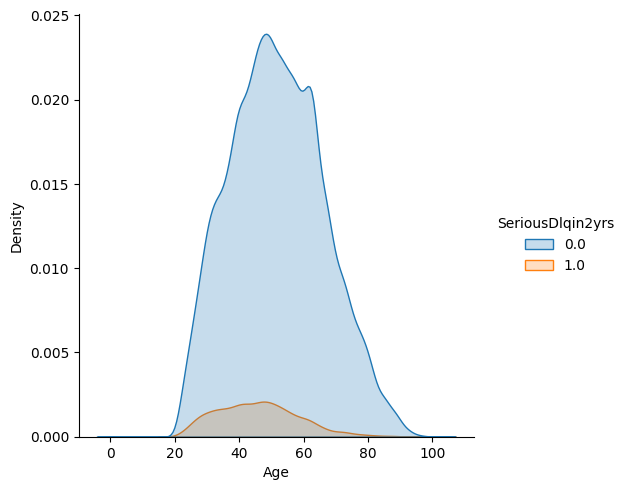

In [57]:
import seaborn as sns
sns.displot(df, x="Age", hue="SeriousDlqin2yrs", kind="kde", fill=True)

In [ ]:
df['RevolvingUtilizationOfUnsecuredLines'] = df['RevolvingUtilizationOfUnsecuredLines'].apply(lambda x: 0 if x < 0 else x)
df['RevolvingUtilizationOfUnsecuredLines'] = df['RevolvingUtilizationOfUnsecuredLines'].apply(lambda x: median(df['RevolvingUtilizationOfUnsecuredLines']) if x > 1 else x)

In [59]:
fig = px.box(df, y="RevolvingUtilizationOfUnsecuredLines")
fig.show()

#### Monthly Income

In [8]:
df = df[df['MonthlyIncome'] >=500]

In [9]:
df = df[df['MonthlyIncome'] <=20000]

In [10]:
fig = px.histogram(df, x="MonthlyIncome", nbins=100)
fig.show()

Most of the population earns between 2000 and 10000 dollars. There are extreme outliers in the monthly income field.

#### Interpretation

Age range of population is mostly between 30 and 60 years. After 70 years the population drops drastically. The age histogram, has a bell like shape, suggesting it has a normal/gaussian-distribution.  The number of dependants is small  since most of the population is in in the working class.                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                         

In [11]:
fig = px.histogram(df, x="Age", nbins=10)
fig.show()

In [61]:
df['Age_bin'] = pd.qcut(df['Age'], q=[0, 0.18, 0.4, 0.65, 1],\
                           labels=['Children', 'Young Adult', 'Adult', 'Aged'])
df['Age_bin']

0                Aged
1                Aged
2            Children
3               Adult
4            Children
             ...     
117936       Children
117937           Aged
117938          Adult
117939           Aged
117940    Young Adult
Name: Age_bin, Length: 117940, dtype: category
Categories (4, object): ['Children' < 'Young Adult' < 'Adult' < 'Aged']

In [65]:
fig = px.scatter(df,
                     x="MonthlyIncome", y="DebtRatio", size="NumberOfOpenCreditLinesAndLoans", color="Age_bin",
                     log_x=True, size_max=60,
                     template='ygridoff')
fig.show()

In [69]:
fig = px.pie(df, values='MonthlyIncome', names='Age_bin', title='MonthlyIncome for Age Groups')
fig.show()

In [13]:
df["SeriousDlqin2yrs"].value_counts()

0.0    107334
1.0      8139
Name: SeriousDlqin2yrs, dtype: int64

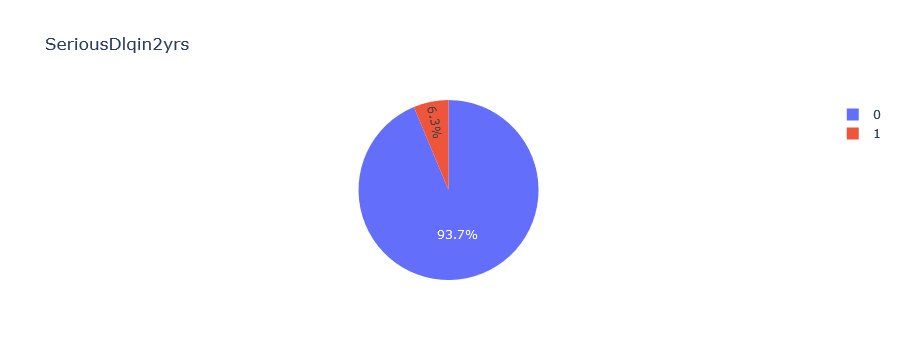

In [52]:
fig = px.pie(df, values='Age', names='SeriousDlqin2yrs', title='SeriousDlqin2yrs')
fig.show()

The monthly income needs to be capped because of a long tail, suggesting presence of outliers which could give false outliers.

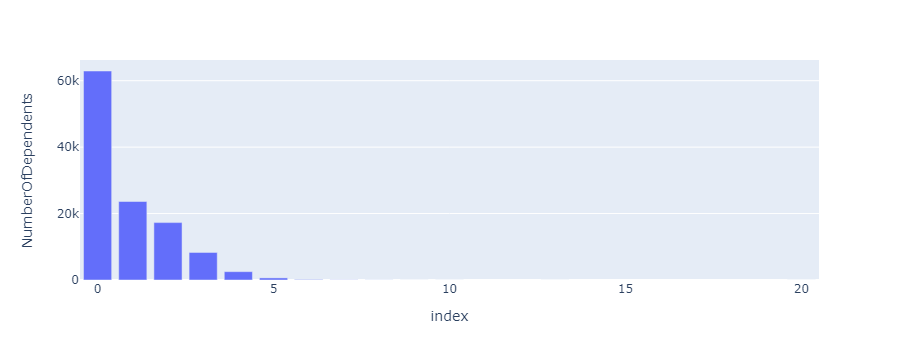

In [15]:
df['NumberOfDependents'] = df['NumberOfDependents'].astype('category')
dependants_df = pd.DataFrame(df['NumberOfDependents'].value_counts())
dependants_df = dependants_df.reset_index()
fig = px.bar(dependants_df, x='index', y='NumberOfDependents')
fig.show()

As observed in the histogram for ages we note that most of the population does not have a dependaNT.
Below shows its boxplot

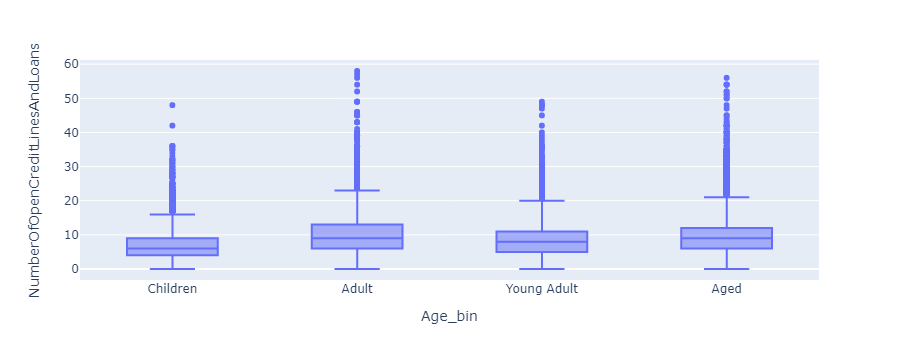

In [53]:
fig = px.box(df, x = "Age_bin",y="NumberOfOpenCreditLinesAndLoans")
fig.show()

The number of open credit lines and loans ranges mainly from 0 and 20 with a heavy upper tail for all ages

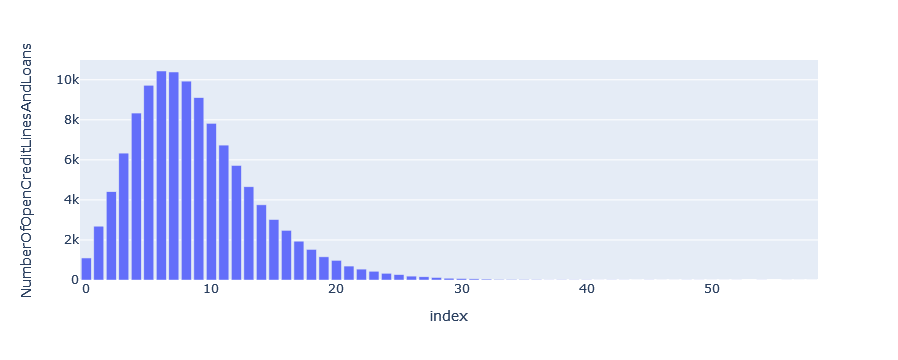

In [24]:
open_df = pd.DataFrame(df["NumberOfOpenCreditLinesAndLoans"].value_counts()).reset_index()
fig = px.bar(open_df, x='index', y='NumberOfOpenCreditLinesAndLoans')
fig.show()

In [25]:
df["NumberOfOpenCreditLinesAndLoans"] = df["NumberOfOpenCreditLinesAndLoans"].astype("category")

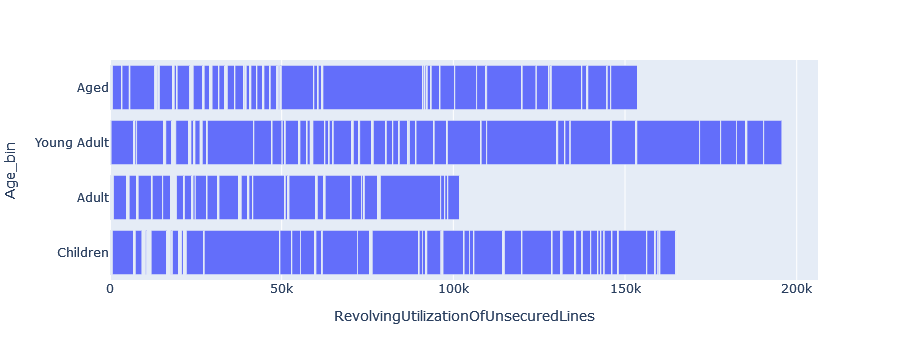

In [ ]:
df["Age"] = df["Age"].astype("category")
fig = px.bar(df, x="RevolvingUtilizationOfUnsecuredLines", y="Age_bin", orientation='h')
fig.show()

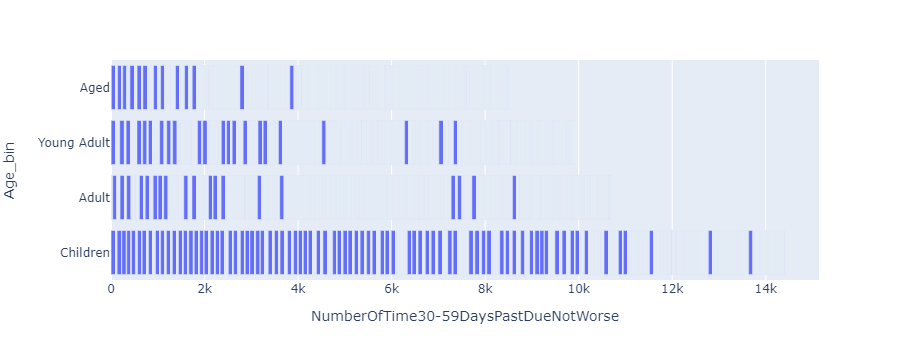

In [ ]:
df["Age"] = df["Age"].astype("category")
fig = px.bar(df, x="NumberOfTime30-59DaysPastDueNotWorse", y="Age_bin", orientation='h')
fig.show()